# Neural Network and Deep Learning with PyTorch (TensorBoard and Hyperparameter Tuning)


In the previous [post](https://saptarshidatta.in/2020/10/05/PyTorch_CIFAR10.html), we achieved a n accuracy around 61%. In this exercise, we will try increasing the accuracy by Hyperparameter Tuning with tensorBoard.

For this exercise, we will use the CIFAR10 dataset. It has the classes: ‘airplane’, ‘automobile’, ‘bird’, ‘cat’, ‘deer’, ‘dog’, ‘frog’, ‘horse’, ‘ship’, ‘truck’. The images in CIFAR-10 are of size 3x32x32, i.e. 3-channel color images of 32x32 pixels in size.

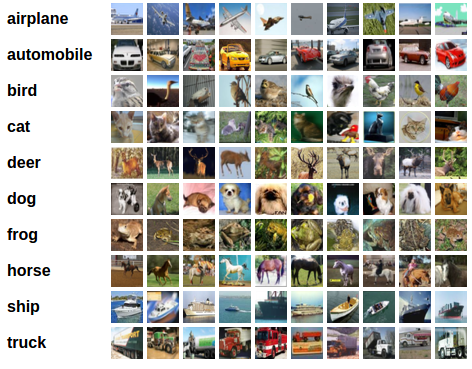


The dataset is divided into five training batches and one test batch, each with 10000 images. The test batch contains exactly 1000 randomly-selected images from each class. The training batches contain the remaining images in random order, but some training batches may contain more images from one class than another. Between them, the training batches contain exactly 5000 images from each class.

In [1]:
pip install tensorboardX

     |████████████████████████████████| 317kB 4.3MB/s 


In [2]:
pip install tensorboard 

In [3]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F

import torchvision
import torchvision.transforms as transforms

import numpy as np
import matplotlib.pyplot as plt

from sklearn.metrics import confusion_matrix

from tensorboardX import SummaryWriter 
from itertools import product

In [4]:
print(torch.__version__)
print(torchvision.__version__)

1.6.0+cu101
0.7.0+cu101


## Loading the CIFAR-10 data and pre-processing

In [5]:
transform =transforms.Compose([transforms.ToTensor(), transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])


train_set = torchvision.datasets.CIFAR10(root = './data', train=True,  transform=transform, download=True)
train_loader = torch.utils.data.DataLoader(train_set, batch_size = 4, shuffle=True)

test_set = torchvision.datasets.CIFAR10(root = './data', train=False, transform=transform, download=True)
test_loader = torch.utils.data.DataLoader(test_set, batch_size=4, shuffle=False)

Extracting ./data/cifar-10-python.tar.gz to ./data
Files already downloaded and verified


## Neural Network and PyTorch design

In [6]:
def get_num_correct(preds, labels):
    return preds.argmax(dim=1).eq(labels).sum().item()

In [7]:
class Network(nn.Module):
  def __init__(self):
    super(Network,self).__init__()
    self.conv1 = nn.Conv2d(in_channels=3, out_channels=6, kernel_size=5)
    self.conv2 = nn.Conv2d(in_channels=6, out_channels=16, kernel_size=5)

    self.fc1 = nn.Linear(in_features=16*5*5, out_features=120)
    self.fc2 = nn.Linear(in_features=120, out_features=84)
    self.out = nn.Linear(in_features=84, out_features=10)

  def forward(self, t):
    #Layer 1
    t = t
    #Layer 2
    t = self.conv1(t)
    t = F.relu(t)
    t = F.max_pool2d(t, kernel_size=2, stride=2)#output shape : (6,14,14)
    #Layer 3
    t = self.conv2(t)
    t = F.relu(t)
    t = F.max_pool2d(t, kernel_size=2, stride=2)#output shape : (16,5,5)
    #Layer 4
    t = t.reshape(-1, 16*5*5)
    t = self.fc1(t)
    t = F.relu(t)#output shape : (1,120)
    #Layer 5
    t = self.fc2(t)
    t = F.relu(t)#output shape : (1, 84)
    #Layer 6/ Output Layer
    t = self.out(t)#output shape : (1,10)

    return t


## Training the Neural Network
At first, we will experiment with various values of learning rate and batch size. We have also used the Shuffle value to True or false inthis particular case for demonstration. Shuffle for a training data should always be set to `True`.

In [8]:
parameters = dict(
    lr = [.01, .001]
    ,batch_size = [100, 1000]
    ,shuffle = [True, False]
)

param_values = [v for v in parameters.values()]
param_values

[[0.01, 0.001], [100, 1000], [True, False]]

In [9]:
for lr, batch_size, shuffle in product(*param_values): 
    print (lr, batch_size, shuffle)

0.01 100 True
0.01 100 False
0.01 1000 True
0.01 1000 False
0.001 100 True
0.001 100 False
0.001 1000 True
0.001 1000 False


We will train the network for each combination for 5 epochs.

In [10]:
for lr, batch_size, shuffle in product(*param_values): 
    comment = f' batch_size={batch_size} lr={lr} shuffle={shuffle}'
    network = Network()
    train_loader = torch.utils.data.DataLoader(train_set, batch_size=batch_size, shuffle=shuffle)
    optimizer = optim.Adam(network.parameters(), lr=lr)
    images, labels = next(iter(train_loader))
    grid = torchvision.utils.make_grid(images)
    tb = SummaryWriter(comment=comment)
    tb.add_image('images', grid)
    tb.add_graph(network, images)
    for epoch in range(5):
        total_loss = 0
        total_correct = 0
        for batch in train_loader:
            images, labels = batch # Get Batch
            preds = network(images) # Pass Batch
            loss = F.cross_entropy(preds, labels) # Calculate Loss
            optimizer.zero_grad() # Zero Gradients
            loss.backward() # Calculate Gradients
            optimizer.step() # Update Weights

            total_loss += loss.item() * batch_size
            total_correct += get_num_correct(preds, labels)

        tb.add_scalar('Loss', total_loss, epoch)
        tb.add_scalar('Number Correct', total_correct, epoch)
        tb.add_scalar('Accuracy', total_correct / len(train_set), epoch)

        for name, param in network.named_parameters():
            tb.add_histogram(name, param, epoch)
            tb.add_histogram(f'{name}.grad', param.grad, epoch)

        print("epoch", epoch, "total_correct:", total_correct, "loss:", total_loss)  
    tb.close()


epoch 0 total_correct: 17513 loss: 87365.08694887161
epoch 1 total_correct: 21969 loss: 76805.04779815674
epoch 2 total_correct: 23226 loss: 73498.25700521469
epoch 3 total_correct: 24073 loss: 71920.34811973572
epoch 4 total_correct: 24743 loss: 70831.32088184357
epoch 0 total_correct: 19299 loss: 83545.03535032272
epoch 1 total_correct: 22928 loss: 74707.7090382576
epoch 2 total_correct: 24424 loss: 71151.44772529602
epoch 3 total_correct: 25189 loss: 69490.38414955139
epoch 4 total_correct: 25827 loss: 68041.38821363449
epoch 0 total_correct: 14989 loss: 93491.79697036743
epoch 1 total_correct: 22610 loss: 74605.50451278687
epoch 2 total_correct: 25653 loss: 67378.54933738708
epoch 3 total_correct: 27591 loss: 62727.439284324646
epoch 4 total_correct: 28857 loss: 59329.286217689514
epoch 0 total_correct: 13854 loss: 96064.404129982
epoch 1 total_correct: 21409 loss: 77837.57710456848
epoch 2 total_correct: 24448 loss: 70355.35216331482
epoch 3 total_correct: 26253 loss: 65895.09534

In [11]:
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

### Hyperparameter Tuning

- We get the highest accuracy with batch size = 100, learning rate = 0.001.

- We get the least loss with batch size = 100, learning rate = 0.001.

- We get the highest number of correct with batch size = 100, learning rate = 0.001

Next, we will train our model with the above hyperparameters for 20 epochs. The Shuffle should always be set to `True` for a dataset that is to be used for training. for better results, try training with 30-40 epochs.

In [27]:
network = Network()
optimizer = optim.Adam(network.parameters(), lr=0.001)
train_loader = torch.utils.data.DataLoader(train_set, batch_size = 100, shuffle=True)
for epoch in range(20):

  total_correct = 0
  total_loss = 0
  for batch in train_loader: #Get batch
    images, labels = batch #Unpack the batch into images and labels
 
    preds = network(images) #Pass batch
    loss = F.cross_entropy(preds, labels) #Calculate Loss

    optimizer.zero_grad()
    loss.backward() #Calculate gradients
    optimizer.step() #Update weights

    total_loss += loss.item()
    total_correct += preds.argmax(dim=1).eq(labels).sum().item()
    
  print('epoch:', epoch, "total_correct:", total_correct, "loss:", total_loss)

print('>>> Training Complete >>>')

epoch: 0 total_correct: 18651 loss: 849.9932324886322
epoch: 1 total_correct: 24504 loss: 705.1673692464828
epoch: 2 total_correct: 26963 loss: 640.5552331209183
epoch: 3 total_correct: 28659 loss: 597.3582971692085
epoch: 4 total_correct: 29962 loss: 562.8402088880539
epoch: 5 total_correct: 30779 loss: 539.0200644135475
epoch: 6 total_correct: 31809 loss: 512.1898544430733
epoch: 7 total_correct: 32519 loss: 492.4339148402214
epoch: 8 total_correct: 33347 loss: 472.16862374544144
epoch: 9 total_correct: 33886 loss: 456.5712361931801
epoch: 10 total_correct: 34368 loss: 440.92613542079926
epoch: 11 total_correct: 34884 loss: 428.22864186763763
epoch: 12 total_correct: 35317 loss: 414.74371790885925
epoch: 13 total_correct: 35869 loss: 402.13817512989044
epoch: 14 total_correct: 36273 loss: 389.99419683218
epoch: 15 total_correct: 36573 loss: 379.3152626156807
epoch: 16 total_correct: 36989 loss: 369.98838609457016
epoch: 17 total_correct: 37453 loss: 357.5710269808769
epoch: 18 total_

## Predictions
We will define a function to get all predictions at once. 

In [28]:
@torch.no_grad()
def get_all_preds(model, loader):
  all_preds = torch.tensor([])
  for batch in loader:
    images, labels = batch

    preds = model(images)
    all_preds = torch.cat((all_preds, preds) ,dim=0)

  return all_preds

In [29]:
test_preds = get_all_preds(network, test_loader)
actual_labels = torch.Tensor(test_set.targets)
preds_correct = test_preds.argmax(dim=1).eq(actual_labels).sum().item()

print('total correct:', preds_correct)
print('accuracy:', preds_correct / len(test_set))

total correct: 6506
accuracy: 0.6506


The model predicted the label with 65 % accuracy, which is better than what we predicted without hyper-parameter tuning. Next, we will develop a confusion matrix which will demonstrate, in which particular areas our model is performing poorly.

## Confusion Matrix

In [30]:
import itertools
import numpy as np
import matplotlib.pyplot as plt

def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

Confusion matrix, without normalization
[[748  38  31  25  18  14  12   8  61  45]
 [ 23 786   6  11   5  15   9   3  22 120]
 [ 83   5 461  91  81 152  61  27  19  20]
 [ 32  11  21 443  54 311  61  27  14  26]
 [ 30   6  58  80 531 129  59  91  11   5]
 [ 17   2  38 145  29 698  18  40   2  11]
 [  6   8  34  94  51  75 700  11  10  11]
 [ 26   3  17  45  55 127   8 689   2  28]
 [ 87  71  12  23   8  15   9   5 728  42]
 [ 44 105   9  26   7  31  16  13  27 722]]


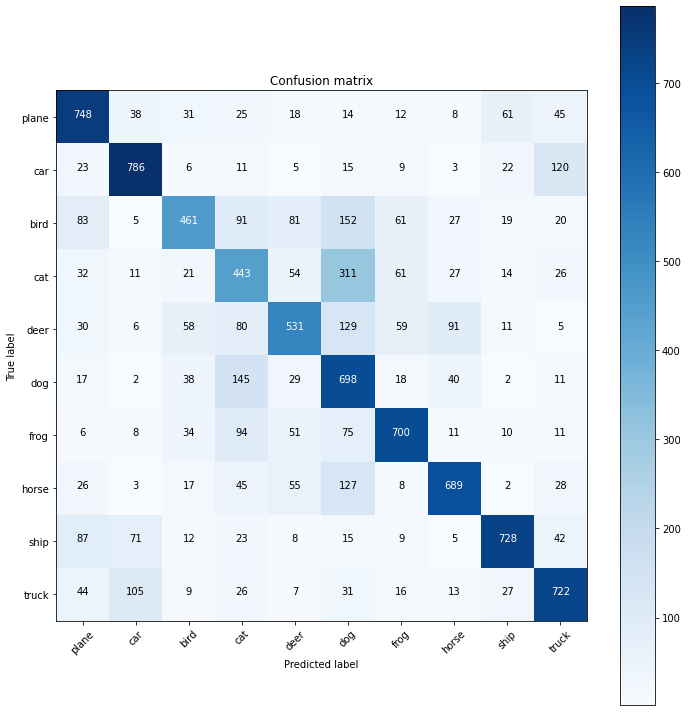

In [31]:
cm = confusion_matrix(test_set.targets, test_preds.argmax(dim=1))
classes = ('plane', 'car', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck')
plt.figure(figsize=(10,10))
plot_confusion_matrix(cm, classes)